In [1]:
# !pip install shap

In [2]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import seaborn as sns

from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from lightgbm import LGBMClassifier
from sklearn.metrics import confusion_matrix, classification_report


In [3]:
import platform
from matplotlib import font_manager, rc

path = "c:/Windows/Fonts/malgun.ttf"

if platform.system() == "Darwin":
    print("Hangul OK in your MAC!!!")
    rc("font", family="Arial Unicode MS")
elif platform.system() == "Windows":
    font_name = font_manager.FontProperties(fname=path).get_name()
    print("Hangul OK in your Windows!!!")
    rc("font", family=font_name)
else:
    print("Unknown system.. sorry~~~")
    
plt.rcParams["axes.unicode_minus"] = False 

Hangul OK in your Windows!!!


In [4]:
df_customer_vip = pd.read_csv('../data/df_customer_vip.csv', index_col=0)
df_customer_vip.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1468 entries, 0 to 1467
Data columns (total 14 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   고객ID       1468 non-null   object 
 1   성별         1468 non-null   object 
 2   고객지역       1468 non-null   object 
 3   가입기간       1468 non-null   int64  
 4   recency    1468 non-null   int64  
 5   frequency  1468 non-null   int64  
 6   monetary   1468 non-null   float64
 7   제품카테고리     1468 non-null   object 
 8   쿠폰상태       1468 non-null   object 
 9   평균구매가치     1468 non-null   float64
 10  고객가치       1468 non-null   float64
 11  고객수명       1468 non-null   int64  
 12  고객생애가치     1468 non-null   float64
 13  vip        1468 non-null   object 
dtypes: float64(4), int64(4), object(6)
memory usage: 172.0+ KB


In [5]:
df_customer_vip

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1358,남,Chicago,12,340,297,36683.62,Nest-USA,Clicked,123.513872,36683.62,1,36683.62,non-vip
1,USER_0190,남,California,43,14,44,3069.51,Nest-USA,Clicked,69.761591,3069.51,10,30695.10,vip
2,USER_0066,남,Chicago,33,152,42,3024.89,Apparel,Clicked,72.021190,3024.89,6,18149.34,non-vip
3,USER_0345,여,California,30,365,1,7.74,Lifestyle,Clicked,7.740000,7.74,1,7.74,non-vip
4,USER_0683,남,California,49,124,6,883.78,Nest-USA,Clicked,147.296667,883.78,7,6186.46,non-vip
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,USER_0513,여,New York,41,1,9,500.21,Office,Used,55.578889,500.21,10,5002.10,non-vip
1464,USER_0167,여,Chicago,48,1,19,3026.08,Nest-USA,Clicked,159.267368,3026.08,10,30260.80,vip
1465,USER_0845,남,New Jersey,19,1,5,761.86,Nest-USA,Clicked,152.372000,761.86,10,7618.60,non-vip
1466,USER_0504,여,New York,45,1,8,1100.75,Nest-USA,Clicked,137.593750,1100.75,10,11007.50,non-vip


In [6]:
df_ml = df_customer_vip.copy()

### 범주형데이터 변환

In [7]:
df_ml

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1358,남,Chicago,12,340,297,36683.62,Nest-USA,Clicked,123.513872,36683.62,1,36683.62,non-vip
1,USER_0190,남,California,43,14,44,3069.51,Nest-USA,Clicked,69.761591,3069.51,10,30695.10,vip
2,USER_0066,남,Chicago,33,152,42,3024.89,Apparel,Clicked,72.021190,3024.89,6,18149.34,non-vip
3,USER_0345,여,California,30,365,1,7.74,Lifestyle,Clicked,7.740000,7.74,1,7.74,non-vip
4,USER_0683,남,California,49,124,6,883.78,Nest-USA,Clicked,147.296667,883.78,7,6186.46,non-vip
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,USER_0513,여,New York,41,1,9,500.21,Office,Used,55.578889,500.21,10,5002.10,non-vip
1464,USER_0167,여,Chicago,48,1,19,3026.08,Nest-USA,Clicked,159.267368,3026.08,10,30260.80,vip
1465,USER_0845,남,New Jersey,19,1,5,761.86,Nest-USA,Clicked,152.372000,761.86,10,7618.60,non-vip
1466,USER_0504,여,New York,45,1,8,1100.75,Nest-USA,Clicked,137.593750,1100.75,10,11007.50,non-vip


In [8]:
from sklearn.preprocessing import LabelEncoder

# 레이블 인코딩 함수
def label_encode_column(df, column_name):
    label_encoder = LabelEncoder()
    df[column_name] = label_encoder.fit_transform(df[column_name])

# 반복문을 사용하여 각 컬럼에 대해 레이블 인코딩 적용
columns_to_encode = ['성별', '고객지역', '제품카테고리', '쿠폰상태']
for column in columns_to_encode:
    label_encode_column(df_ml, column)

df_ml

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1358,0,1,12,340,297,36683.62,8,0,123.513872,36683.62,1,36683.62,non-vip
1,USER_0190,0,0,43,14,44,3069.51,8,0,69.761591,3069.51,10,30695.10,vip
2,USER_0066,0,1,33,152,42,3024.89,1,0,72.021190,3024.89,6,18149.34,non-vip
3,USER_0345,1,0,30,365,1,7.74,5,0,7.740000,7.74,1,7.74,non-vip
4,USER_0683,0,0,49,124,6,883.78,8,0,147.296667,883.78,7,6186.46,non-vip
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,USER_0513,1,3,41,1,9,500.21,10,2,55.578889,500.21,10,5002.10,non-vip
1464,USER_0167,1,1,48,1,19,3026.08,8,0,159.267368,3026.08,10,30260.80,vip
1465,USER_0845,0,2,19,1,5,761.86,8,0,152.372000,761.86,10,7618.60,non-vip
1466,USER_0504,1,3,45,1,8,1100.75,8,0,137.593750,1100.75,10,11007.50,non-vip


In [9]:
# vip 컬럼의 값에 따라 각각의 데이터프레임을 생성
df_non_vip = df_ml[df_ml['vip'] == 'non-vip']
df_vip = df_ml[df_ml['vip'] == 'vip']
df_potential_vip = df_ml[df_ml['vip'] == '잠재적vip']

# 각각의 데이터프레임에서 랜덤하게 3개씩 샘플링
df_non_vip_sampled = df_non_vip.sample(n=3, random_state=42)
df_vip_sampled = df_vip.sample(n=3, random_state=42)
df_potential_vip_sampled = df_potential_vip.sample(n=3, random_state=42)

# 샘플링된 데이터프레임을 하나로 결합
df_final = pd.concat([df_non_vip_sampled, df_vip_sampled, df_potential_vip_sampled])

# 인덱스를 재설정
df_final.reset_index(drop=True, inplace=True)

df_final

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1049,0,3,31,181,87,8382.63,8,0,96.352069,8382.63,6,50295.78,non-vip
1,USER_0040,1,3,39,167,14,1057.78,1,0,75.555714,1057.78,6,6346.68,non-vip
2,USER_0026,0,0,32,266,147,17418.69,1,0,118.494490,17418.69,3,52256.07,non-vip
3,USER_1077,0,1,39,19,105,10925.66,1,0,104.053905,10925.66,10,109256.60,vip
4,USER_1355,0,0,21,18,572,50786.24,1,0,88.787133,50786.24,10,507862.40,vip
5,USER_1267,1,1,25,22,213,18226.01,1,0,85.568122,18226.01,10,182260.10,vip
6,USER_0414,0,1,45,64,115,11704.94,1,0,101.782087,11704.94,9,105344.46,잠재적vip
7,USER_1000,1,4,50,82,59,4776.45,1,0,80.956780,4776.45,8,38211.60,잠재적vip
8,USER_0608,1,1,26,103,59,4834.26,8,0,81.936610,4834.26,8,38674.08,잠재적vip


In [10]:
len(df_final)

9

In [11]:
# 최종 테스트 항목을 제외한 행을 삭제
values_to_drop = ['USER_1049', 'USER_0040', 'USER_0026', 'USER_1077', 
                  'USER_1355', 'USER_1267', 'USER_0414', 'USER_1000', 'USER_0608']
for value in values_to_drop:
    df_ml = df_ml[df_ml['고객ID'] != value]

In [12]:
df_ml_copy = df_ml.copy()
df_ml_copy

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1358,0,1,12,340,297,36683.62,8,0,123.513872,36683.62,1,36683.62,non-vip
1,USER_0190,0,0,43,14,44,3069.51,8,0,69.761591,3069.51,10,30695.10,vip
2,USER_0066,0,1,33,152,42,3024.89,1,0,72.021190,3024.89,6,18149.34,non-vip
3,USER_0345,1,0,30,365,1,7.74,5,0,7.740000,7.74,1,7.74,non-vip
4,USER_0683,0,0,49,124,6,883.78,8,0,147.296667,883.78,7,6186.46,non-vip
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,USER_0513,1,3,41,1,9,500.21,10,2,55.578889,500.21,10,5002.10,non-vip
1464,USER_0167,1,1,48,1,19,3026.08,8,0,159.267368,3026.08,10,30260.80,vip
1465,USER_0845,0,2,19,1,5,761.86,8,0,152.372000,761.86,10,7618.60,non-vip
1466,USER_0504,1,3,45,1,8,1100.75,8,0,137.593750,1100.75,10,11007.50,non-vip


In [13]:
# vip 컬럼의 값을 숫자로 변환
df_ml_copy['vip'] = df_ml_copy['vip'].map({'non-vip': 3, 'vip': 1, '잠재적vip': 2})
df_ml_copy

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1358,0,1,12,340,297,36683.62,8,0,123.513872,36683.62,1,36683.62,3
1,USER_0190,0,0,43,14,44,3069.51,8,0,69.761591,3069.51,10,30695.10,1
2,USER_0066,0,1,33,152,42,3024.89,1,0,72.021190,3024.89,6,18149.34,3
3,USER_0345,1,0,30,365,1,7.74,5,0,7.740000,7.74,1,7.74,3
4,USER_0683,0,0,49,124,6,883.78,8,0,147.296667,883.78,7,6186.46,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,USER_0513,1,3,41,1,9,500.21,10,2,55.578889,500.21,10,5002.10,3
1464,USER_0167,1,1,48,1,19,3026.08,8,0,159.267368,3026.08,10,30260.80,1
1465,USER_0845,0,2,19,1,5,761.86,8,0,152.372000,761.86,10,7618.60,3
1466,USER_0504,1,3,45,1,8,1100.75,8,0,137.593750,1100.75,10,11007.50,3


### 상관관계 분석

In [14]:
df_corr = df_ml_copy.drop(columns=['고객ID']).copy()

<Axes: >

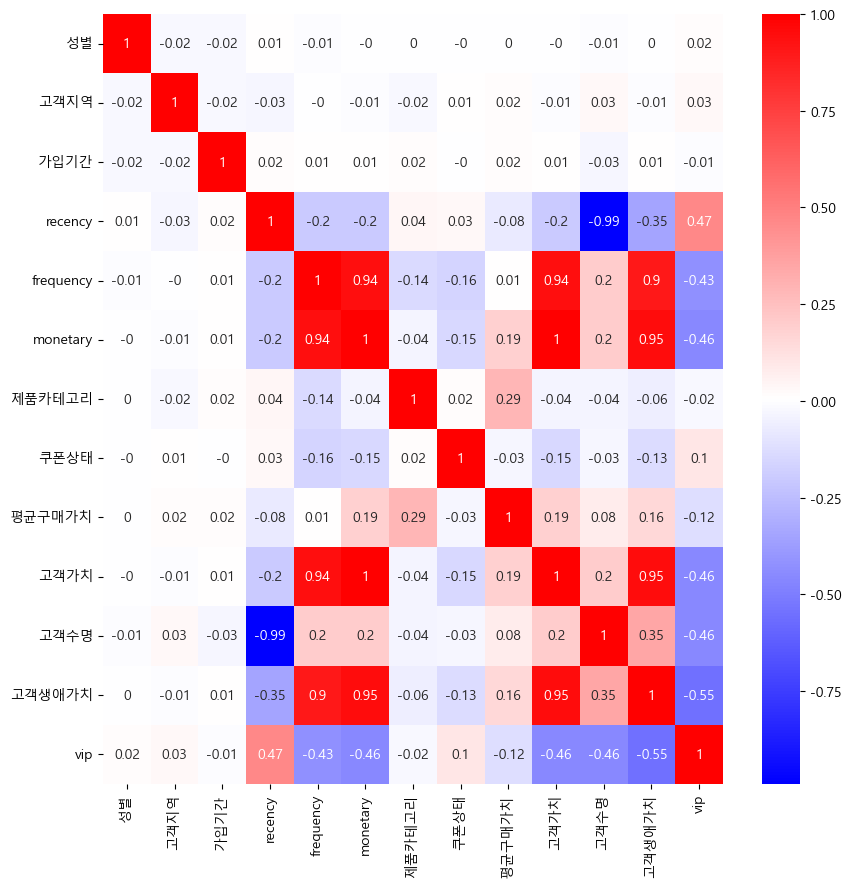

In [15]:
plt.figure(figsize=(10, 10))
correlation_matrix = df_corr.corr(numeric_only=True).round(2)
sns.heatmap(data = correlation_matrix, annot=True, cmap='bwr')

### 데이터 분포도 확인_범주형 데이터 제외
#### 가입기간, recency, frequency, monetary

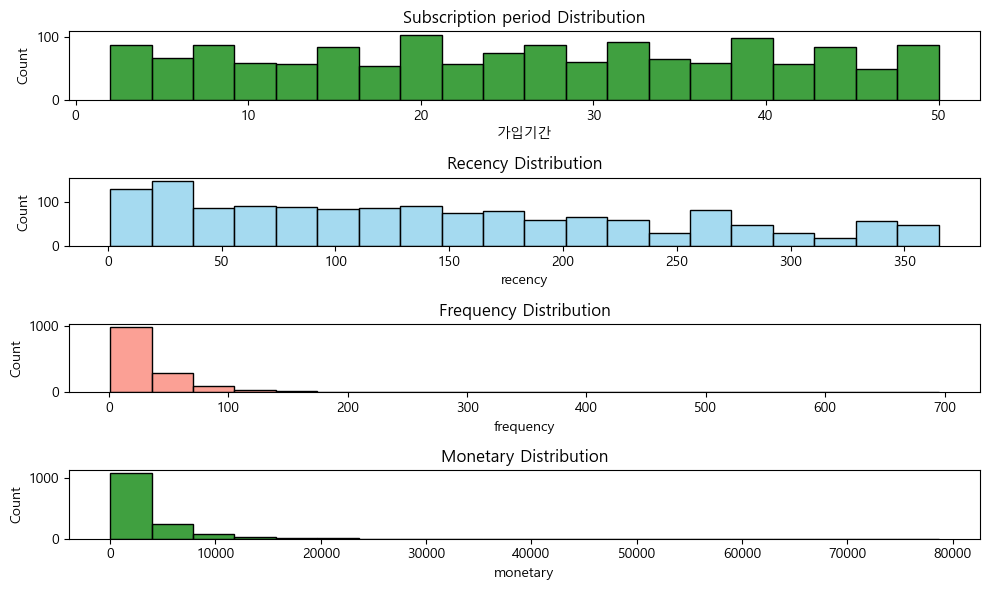

In [16]:
plt.figure(figsize=(10, 6))

plt.subplot(4, 1, 1)
sns.histplot(data=df_ml_copy, x='가입기간', bins=20,color='green')
plt.title('Subscription period Distribution')

plt.subplot(4, 1, 2)
sns.histplot(data=df_ml_copy, x='recency', bins=20, color='skyblue')
plt.title('Recency Distribution')

plt.subplot(4, 1, 3)
sns.histplot(data=df_ml_copy, x='frequency', bins=20, color='salmon')
plt.title('Frequency Distribution')

plt.subplot(4, 1, 4)
sns.histplot(data=df_ml_copy, x='monetary', bins=20,color='green')
plt.title('Monetary Distribution')

plt.tight_layout()
plt.show()

#### 평균구매가치, 고객가치, 고객수명, 고객생애가치 분포도

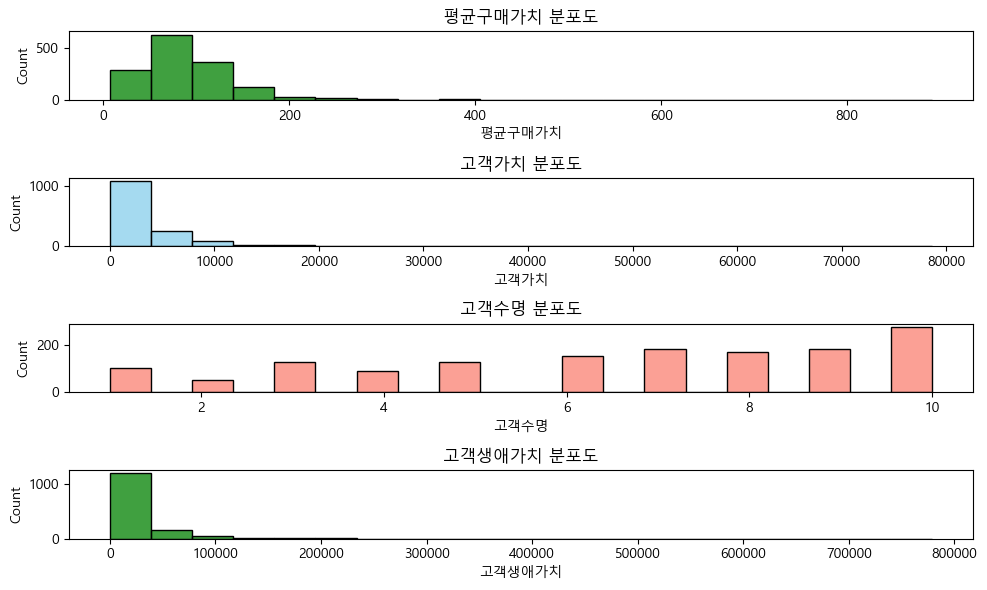

In [17]:
plt.figure(figsize=(10, 6))

plt.subplot(4, 1, 1)
sns.histplot(data=df_ml_copy, x='평균구매가치', bins=20,color='green')
plt.title('평균구매가치 분포도')

plt.subplot(4, 1, 2)
sns.histplot(data=df_ml_copy, x='고객가치', bins=20, color='skyblue')
plt.title('고객가치 분포도')

plt.subplot(4, 1, 3)
sns.histplot(data=df_ml_copy, x='고객수명', bins=20, color='salmon')
plt.title('고객수명 분포도')

plt.subplot(4, 1, 4)
sns.histplot(data=df_ml_copy, x='고객생애가치', bins=20,color='green')
plt.title('고객생애가치 분포도')

plt.tight_layout()
plt.show()

### scale_StandardScaler, RobustScaler, logsacle 비교

### StandardScaler

In [18]:
df_ml_copy.columns[1:-1]

Index(['성별', '고객지역', '가입기간', 'recency', 'frequency', 'monetary', '제품카테고리',
       '쿠폰상태', '평균구매가치', '고객가치', '고객수명', '고객생애가치'],
      dtype='object')

In [19]:
df_ml_ss = df_ml_copy.copy()
ss = StandardScaler()

for column in df_ml_ss.columns[1:-1]:
    # 2차원 배열로 변환
    column_data = df_ml_ss[column].values.reshape(-1, 1)
    # StandardScaler를 사용하여 스케일링
    scaled_data = ss.fit_transform(column_data)
    # 스케일링된 결과를 다시 해당 열에 할당
    df_ml_ss[column] = scaled_data

### RobustScaler

In [20]:
df_ml_rs = df_ml_copy.copy()
rs = RobustScaler()

for column in df_ml_rs.columns[1:-1]:
    # 2차원 배열로 변환
    column_data = df_ml_rs[column].values.reshape(-1, 1)
    # StandardScaler를 사용하여 스케일링
    scaled_data = rs.fit_transform(column_data)
    # 스케일링된 결과를 다시 해당 열에 할당
    df_ml_rs[column] = scaled_data

### logscale

In [21]:
df_ml_log = df_ml_copy.copy()

for column in df_ml_log.columns[1:-1]:
    # 2차원 배열로 변환
    column_data = df_ml_log[column].values.reshape(-1, 1)
    # StandardScaler를 사용하여 스케일링
    scaled_data = np.log1p(column_data)
    # 스케일링된 결과를 다시 해당 열에 할당
    df_ml_log[column] = scaled_data

### 각 scale boxplot 시각화
- log scale 시 데이터가 아래값으로 치우쳐지지 않음을 확인하여 결정

### StandardScaler

In [22]:
df_ml_ss.columns

Index(['고객ID', '성별', '고객지역', '가입기간', 'recency', 'frequency', 'monetary',
       '제품카테고리', '쿠폰상태', '평균구매가치', '고객가치', '고객수명', '고객생애가치', 'vip'],
      dtype='object')

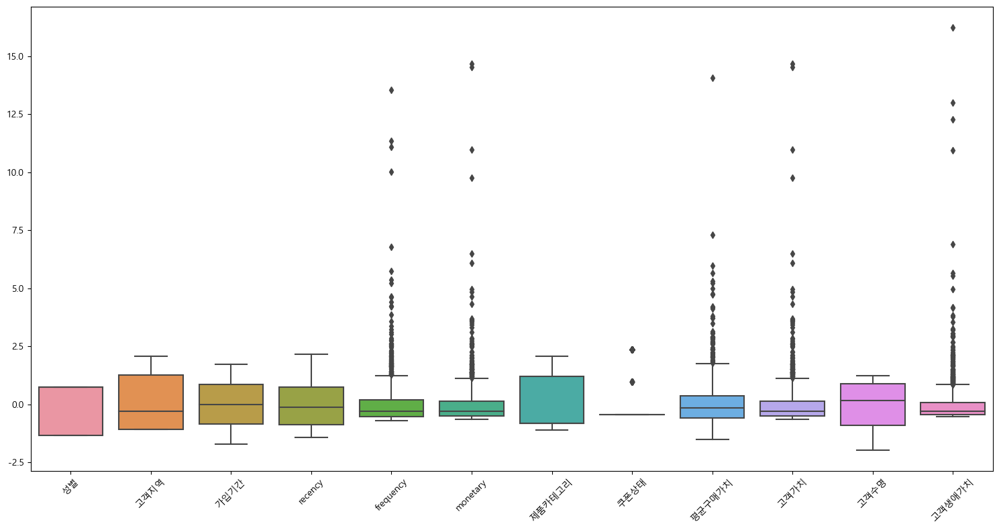

In [23]:
column = ['성별', '고객지역', '가입기간', 'recency', 'frequency', 'monetary', 
          '제품카테고리', '쿠폰상태', '평균구매가치', '고객가치', '고객수명', '고객생애가치']

plt.figure(figsize=(15, 8))
sns.boxplot(data=df_ml_ss[column])
plt.xticks(rotation=45)  # x축 레이블 회전
plt.tight_layout()
plt.show()

### RobustScaler

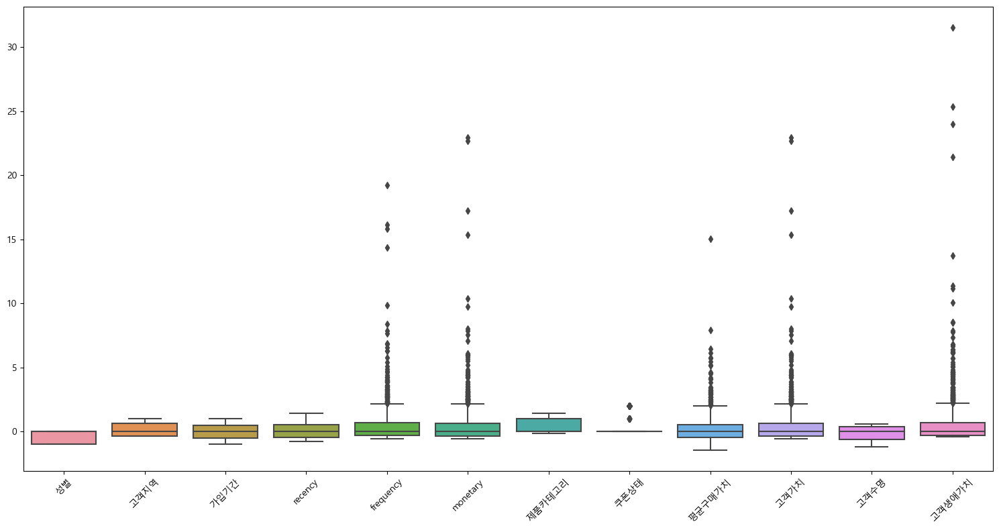

In [24]:
column = ['성별', '고객지역', '가입기간', 'recency', 'frequency', 'monetary', 
          '제품카테고리', '쿠폰상태', '평균구매가치', '고객가치', '고객수명', '고객생애가치']

plt.figure(figsize=(15, 8))
sns.boxplot(data=df_ml_rs[column])
plt.xticks(rotation=45)  # x축 레이블 회전
plt.tight_layout()
plt.show()

### logscale

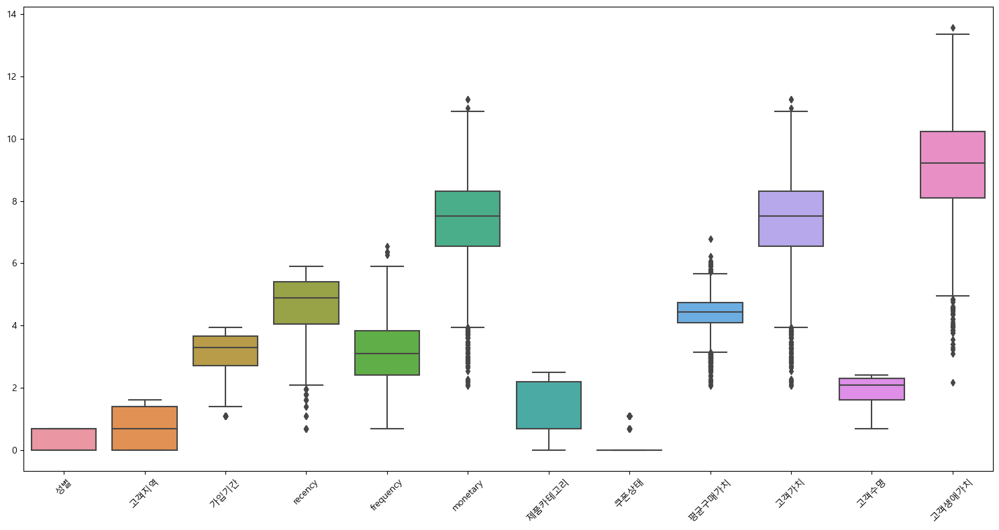

In [25]:
column = ['성별', '고객지역', '가입기간', 'recency', 'frequency', 'monetary', 
          '제품카테고리', '쿠폰상태', '평균구매가치', '고객가치', '고객수명', '고객생애가치']

plt.figure(figsize=(15, 8))
sns.boxplot(data=df_ml_log[column])
plt.xticks(rotation=45)  # x축 레이블 회전
plt.tight_layout()
plt.show()

### 원본데이터 머신러닝
### 데이터분리
- labels : vip: 1, 잠재적vip: 2, non-vip: 3

In [26]:
X = df_ml_copy.drop(columns=['고객ID', 'vip'], axis=1)
y = df_ml_copy['vip']

In [27]:
X.shape, y.shape

((1459, 12), (1459,))

In [28]:
from sklearn.model_selection import train_test_split

# 8:2 확률로 특성(features)과 정답(labels)을 분리
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2, # test_size= : 분리 기준 설정
                                                    # train : 80%, test : 20% 로 데이터 분리
                                                    stratify=y,
                                                    # stratify= : 나눈 데이터에 labels 수를 동일한 비율로 맞춰주는 설정, 
                                                    # train와 test 각각에 labels를 비슷한 비율로 유지
                                                    random_state=13)


In [29]:
X_train.shape, X_test.shape

((1167, 12), (292, 12))

In [30]:
y_train.shape, y_test.shape

((1167,), (292,))

In [31]:
# 위에서 1167, 292 개로 나눈 데이터에 3가지 속성의 값들이 동일한 비율로 들어가있는지 확인, 비율이 동일한 것이 좋은 데이터
np.unique(y_train, return_counts=True)

(array([1, 2, 3], dtype=int64), array([ 86, 112, 969], dtype=int64))

In [32]:
np.unique(y_test, return_counts=True)

(array([1, 2, 3], dtype=int64), array([ 21,  28, 243], dtype=int64))

### vip의 분포도 및 oversampling

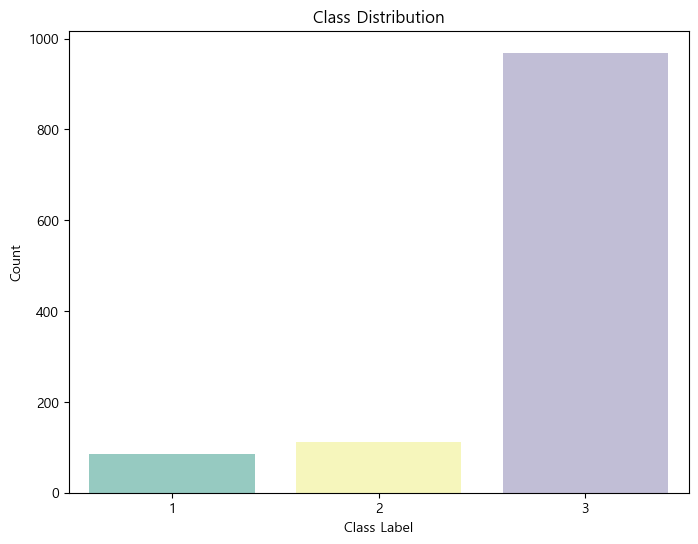

In [33]:
# 클래스 분포 시각화
plt.figure(figsize=(8, 6))
sns.countplot(x=y_train, palette='Set3')
plt.title('Class Distribution')
plt.xlabel('Class Label')
plt.ylabel('Count')
plt.show()

In [34]:
# SMOTE 적용
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=13)
X_train_over, y_train_over = smote.fit_resample(X_train, y_train)   #트레인만 건드림

# 얼마나 늘어났는지 확인
X_train.shape, y_train.shape, X_train_over.shape, y_train_over.shape

((1167, 12), (1167,), (2907, 12), (2907,))

In [35]:
print(np.unique(y_train_over, return_counts=True))

(array([1, 2, 3], dtype=int64), array([969, 969, 969], dtype=int64))


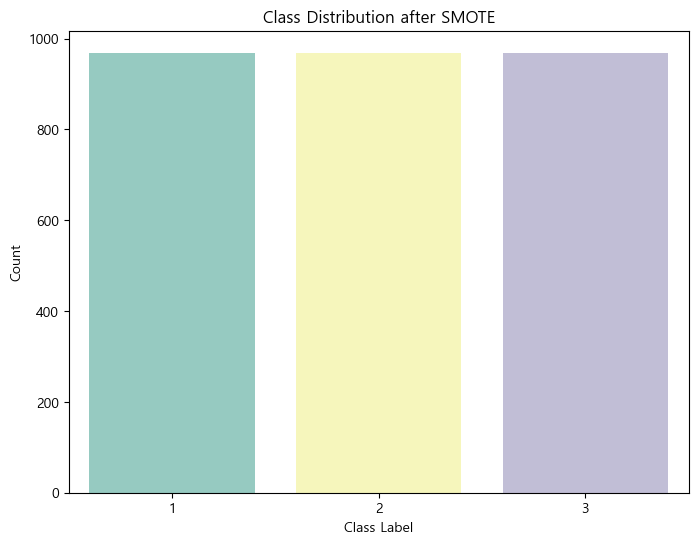

In [36]:
# 클래스 분포 시각화
plt.figure(figsize=(8, 6))
sns.countplot(x=y_train_over, palette='Set3')
plt.title('Class Distribution after SMOTE')
plt.xlabel('Class Label')
plt.ylabel('Count')
plt.show()

### DecisionTreeClassifier

In [37]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score


# StratifiedKFold를 사용한 교차 검증 설정
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=13)

# Decision Tree 분류기 생성
decision_tree = DecisionTreeClassifier()

# GridSearchCV를 사용한 모델 검색
param_grid = {
    'max_depth': [3, 6, 9],  # 의사결정트리의 최대 깊이
    'min_samples_split': [2, 5, 10],  # 내부 노드를 분할하는 데 필요한 최소 샘플 수
    'min_samples_leaf': [1, 2, 4]  # 리프 노드에 필요한 최소 샘플 수
}

over_grid_dt = GridSearchCV(estimator=decision_tree, param_grid=param_grid, cv=stratified_kfold, scoring='accuracy')

# 모델 학습
over_grid_dt.fit(X_train_over, y_train_over)
dt_y_pred_train = over_grid_dt.predict(X_train_over)
dt_y_pred_test = over_grid_dt.predict(X_test)


In [38]:
# 최적의 모델과 파라미터 출력
print("Best parameters found: ", over_grid_dt.best_params_)
print("Best accuracy found: ", over_grid_dt.best_score_)

score_df = pd.DataFrame(over_grid_dt.cv_results_)
score_df[['params', 'rank_test_score', 'mean_test_score', 'std_test_score']].head()

Best parameters found:  {'max_depth': 9, 'min_samples_leaf': 1, 'min_samples_split': 10}
Best accuracy found:  0.9962157909990477


,params,rank_test_score,mean_test_score,std_test_score
0,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",19,0.988995,0.004933
1,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",19,0.988995,0.004933
2,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",19,0.988995,0.004933
3,"{'max_depth': 3, 'min_samples_leaf': 2, 'min_s...",19,0.988995,0.004933
4,"{'max_depth': 3, 'min_samples_leaf': 2, 'min_s...",19,0.988995,0.004933


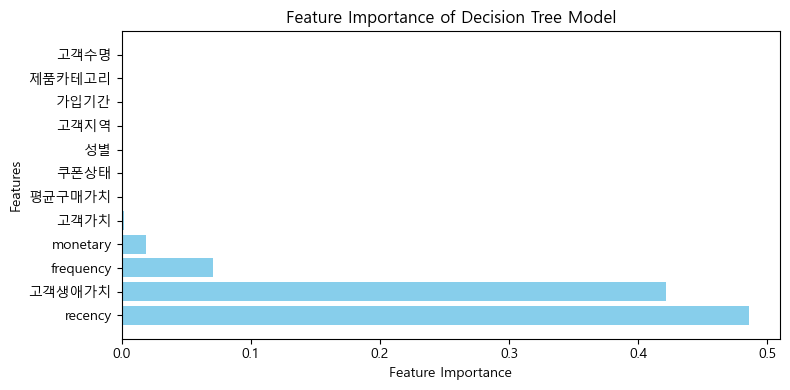

In [39]:
# 최적 모델 얻기
best_model = over_grid_dt.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train_over.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=True))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of Decision Tree Model')
plt.tight_layout()
plt.show()


In [40]:
# 각 성능 지표 계산
# train
dt_tr_accuracy = accuracy_score(y_train_over, dt_y_pred_train)
dt_tr_precision = precision_score(y_train_over, dt_y_pred_train, average='weighted')
dt_tr_recall = recall_score(y_train_over, dt_y_pred_train, average='weighted')
dt_tr_f1 = f1_score(y_train_over, dt_y_pred_train, average='weighted')

# test
dt_test_accuracy = accuracy_score(y_test, dt_y_pred_test)
dt_test_precision = precision_score(y_test, dt_y_pred_test, average='weighted')
dt_test_recall = recall_score(y_test, dt_y_pred_test, average='weighted')
dt_test_f1 = f1_score(y_test, dt_y_pred_test, average='weighted')

# 성능 지표 출력
print("Train Accuracy:", dt_tr_accuracy)
print("Train Precision:", dt_tr_precision)
print("Train Recall:", dt_tr_recall)
print("Train F1 Score:", dt_tr_f1)
print('=' * 50)
print("Test Accuracy:", dt_test_accuracy)
print("Test Precision:", dt_test_precision)
print("Test Recall:", dt_test_recall)
print("Test F1 Score:", dt_test_f1)

Train Accuracy: 0.9993120055039559
Train Precision: 0.9993134225883968
Train Recall: 0.9993120055039559
Train F1 Score: 0.9993121825474971
Test Accuracy: 0.9863013698630136
Test Precision: 0.9871243923994698
Test Recall: 0.9863013698630136
Test F1 Score: 0.9864231287300756


In [41]:
# classification report 출력
print("Train Classification Report:")
print(classification_report(y_train_over, dt_y_pred_train))

print("Test Classification Report:")
print(classification_report(y_test, dt_y_pred_test))

Train Classification Report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.00       969
           2       1.00      1.00      1.00       969
           3       1.00      1.00      1.00       969

    accuracy                           1.00      2907
   macro avg       1.00      1.00      1.00      2907
weighted avg       1.00      1.00      1.00      2907

Test Classification Report:
              precision    recall  f1-score   support

           1       0.95      0.90      0.93        21
           2       0.90      1.00      0.95        28
           3       1.00      0.99      1.00       243

    accuracy                           0.99       292
   macro avg       0.95      0.97      0.96       292
weighted avg       0.99      0.99      0.99       292



In [42]:
# confusion matrix 출력
print("Train Confusion Matrix:")
print(confusion_matrix(y_train_over, dt_y_pred_train))

print("Test Confusion Matrix:")
print(confusion_matrix(y_test, dt_y_pred_test))

Train Confusion Matrix:
[[968   1   0]
 [  0 969   0]
 [  0   1 968]]
Test Confusion Matrix:
[[ 19   2   0]
 [  0  28   0]
 [  1   1 241]]


### RandomForestClassifier

In [43]:
from sklearn.ensemble import RandomForestClassifier

# StratifiedKFold를 사용한 교차 검증 설정
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=13)

# Random Forest 분류기 생성
random_forest = RandomForestClassifier()

# GridSearchCV를 사용한 모델 검색
param_grid = {
    'n_estimators': [100, 200, 300],  # 트리의 개수
    'max_depth': [3, 6, 9],  # 트리의 최대 깊이
    'min_samples_split': [2, 5, 10],  # 내부 노드를 분할하는 데 필요한 최소 샘플 수
    'min_samples_leaf': [1, 2, 4]  # 리프 노드에 필요한 최소 샘플 수
}

over_grid_rf = GridSearchCV(estimator=random_forest, param_grid=param_grid, cv=stratified_kfold, scoring='accuracy')

# 모델 학습
over_grid_rf.fit(X_train_over, y_train_over)
rf_y_pred_train = over_grid_rf.predict(X_train_over)
rf_y_pred_test = over_grid_rf.predict(X_test)

In [44]:
# 최적의 모델과 파라미터 출력
print("Best parameters found: ", over_grid_rf.best_params_)
print("Best accuracy found: ", over_grid_rf.best_score_)

score_df = pd.DataFrame(over_grid_rf.cv_results_)
score_df[['params', 'rank_test_score', 'mean_test_score', 'std_test_score']].head()

Best parameters found:  {'max_depth': 9, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 200}
Best accuracy found:  0.9955273228407


,params,rank_test_score,mean_test_score,std_test_score
0,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",66,0.973855,0.009136
1,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",57,0.974891,0.006835
2,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",77,0.970761,0.006613
3,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",80,0.970418,0.006277
4,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",61,0.974547,0.006269


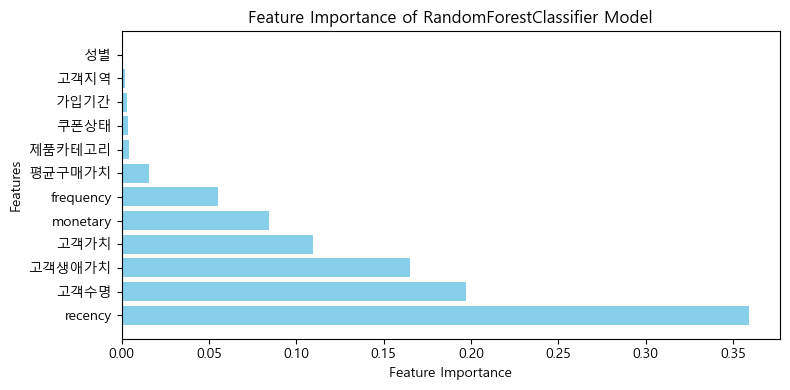

In [45]:
# 최적 모델 얻기
best_model = over_grid_rf.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train_over.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=True))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of RandomForestClassifier Model')
plt.tight_layout()
plt.show()

In [46]:
# 각 성능 지표 계산
# train
rf_tr_accuracy = accuracy_score(y_train_over, rf_y_pred_train)
rf_tr_precision = precision_score(y_train_over, rf_y_pred_train, average='weighted')
rf_tr_recall = recall_score(y_train_over, rf_y_pred_train, average='weighted')
rf_tr_f1 = f1_score(y_train_over, rf_y_pred_train, average='weighted')

# test
rf_test_accuracy = accuracy_score(y_test, rf_y_pred_test)
rf_test_precision = precision_score(y_test, rf_y_pred_test, average='weighted')
rf_test_recall = recall_score(y_test, rf_y_pred_test, average='weighted')
rf_test_f1 = f1_score(y_test, rf_y_pred_test, average='weighted')

# 성능 지표 출력
print("Train Accuracy:", rf_tr_accuracy)
print("Train Precision:", rf_tr_precision)
print("Train Recall:", rf_tr_recall)
print("Train F1 Score:", rf_tr_f1)
print('=' * 50)
print("Test Accuracy:", rf_test_accuracy)
print("Test Precision:", rf_test_precision)
print("Test Recall:", rf_test_recall)
print("Test F1 Score:", rf_test_f1)

Train Accuracy: 0.9989680082559339
Train Precision: 0.9989711934156378
Train Recall: 0.9989680082559339
Train F1 Score: 0.9989680057830016
Test Accuracy: 0.9897260273972602
Test Precision: 0.9903074685344977
Test Recall: 0.9897260273972602
Test F1 Score: 0.9898399686741731


In [71]:
# classification report 출력
print("Train Classification Report:")
print(classification_report(y_train_over, rf_y_pred_train))

print("Test Classification Report:")
print(classification_report(y_test, rf_y_pred_test))

Train Classification Report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.00       969
           2       1.00      1.00      1.00       969
           3       1.00      1.00      1.00       969

    accuracy                           1.00      2907
   macro avg       1.00      1.00      1.00      2907
weighted avg       1.00      1.00      1.00      2907

Test Classification Report:
              precision    recall  f1-score   support

           1       0.91      1.00      0.95        21
           2       1.00      0.96      0.98        28
           3       1.00      0.99      0.99       243

    accuracy                           0.99       292
   macro avg       0.97      0.99      0.98       292
weighted avg       0.99      0.99      0.99       292



In [72]:
# confusion matrix 출력
print("Train Confusion Matrix:")
print(confusion_matrix(y_train_over, rf_y_pred_train))

print("Test Confusion Matrix:")
print(confusion_matrix(y_test, rf_y_pred_test))

Train Confusion Matrix:
[[969   0   0]
 [  0 969   0]
 [  0   3 966]]
Test Confusion Matrix:
[[ 21   0   0]
 [  0  27   1]
 [  2   0 241]]


### LGBMClassifier

In [48]:
from lightgbm import LGBMClassifier

# StratifiedKFold를 사용한 교차 검증 설정
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# LightGBM 분류기 생성
lgbm_classifier = LGBMClassifier()

# GridSearchCV를 사용한 모델 검색
param_grid = {
    'learning_rate': [0.01, 0.05, 0.1], # 각 트리의 가중치 업데이트에 사용되는 학습률
    'n_estimators': [100, 200, 300], # 생성할 트리의 수
    'max_depth': [3, 6, 9], 
    'min_child_weight': [1, 2, 4], # 각 트리에서 샘플의 최소 가중치 총합, 값이 높을수록 모델은 보수적으로 편향
}

over_grid_lgbm = GridSearchCV(estimator=lgbm_classifier, param_grid=param_grid, cv=stratified_kfold, scoring='accuracy')

# 모델 학습
over_grid_lgbm.fit(X_train_over, y_train_over)
lgbm_y_pred_train = over_grid_lgbm.predict(X_train_over)
lgbm_y_pred_test = over_grid_lgbm.predict(X_test)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000685 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1518
[LightGBM] [Info] Number of data points in the train set: 2325, number of used features: 12
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spli

In [49]:
# 최적의 모델과 파라미터 출력
print("Best parameters found: ", over_grid_lgbm.best_params_)
print("Best accuracy found: ", over_grid_lgbm.best_score_)

score_df = pd.DataFrame(over_grid_lgbm.cv_results_)
score_df[['params', 'rank_test_score', 'mean_test_score', 'std_test_score']].head()

Best parameters found:  {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 4, 'n_estimators': 200}
Best accuracy found:  0.9948400376173323


,params,rank_test_score,mean_test_score,std_test_score
0,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",80,0.987958,0.003269
1,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",76,0.991398,0.003082
2,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",68,0.993807,0.001756
3,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",80,0.987958,0.003269
4,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",76,0.991398,0.003082


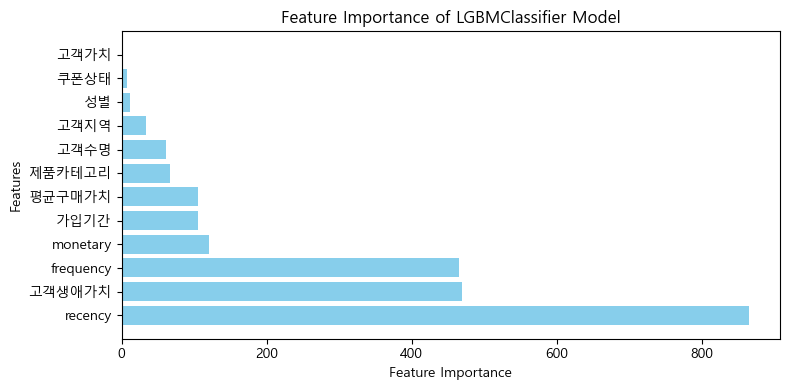

In [50]:
# 최적 모델 얻기
best_model = over_grid_lgbm.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train_over.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=True))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of LGBMClassifier Model')
plt.tight_layout()
plt.show()

In [51]:
# 각 성능 지표 계산
# train
lgbm_tr_accuracy = accuracy_score(y_train_over, lgbm_y_pred_train)
lgbm_tr_precision = precision_score(y_train_over, lgbm_y_pred_train, average='weighted')
lgbm_tr_recall = recall_score(y_train_over, lgbm_y_pred_train, average='weighted')
lgbm_tr_f1 = f1_score(y_train_over, lgbm_y_pred_train, average='weighted')

# test
lgbm_test_accuracy = accuracy_score(y_test, lgbm_y_pred_test)
lgbm_test_precision = precision_score(y_test, lgbm_y_pred_test, average='weighted')
lgbm_test_recall = recall_score(y_test, lgbm_y_pred_test, average='weighted')
lgbm_test_f1 = f1_score(y_test, lgbm_y_pred_test, average='weighted')

# 성능 지표 출력
print("Train Accuracy:", lgbm_tr_accuracy)
print("Train Precision:", lgbm_tr_precision)
print("Train Recall:", lgbm_tr_recall)
print("Train F1 Score:", lgbm_tr_f1)
print('=' * 50)
print("Test Accuracy:", lgbm_test_accuracy)
print("Test Precision:", lgbm_test_precision)
print("Test Recall:", lgbm_test_recall)
print("Test F1 Score:", lgbm_test_f1)

Train Accuracy: 1.0
Train Precision: 1.0
Train Recall: 1.0
Train F1 Score: 1.0
Test Accuracy: 0.9897260273972602
Test Precision: 0.9900114155251141
Test Recall: 0.9897260273972602
Test F1 Score: 0.9897152961127809


In [52]:
# classification report 출력
print("Train Classification Report:")
print(classification_report(y_train_over, lgbm_y_pred_train))

print("Test Classification Report:")
print(classification_report(y_test, lgbm_y_pred_test))

Train Classification Report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.00       969
           2       1.00      1.00      1.00       969
           3       1.00      1.00      1.00       969

    accuracy                           1.00      2907
   macro avg       1.00      1.00      1.00      2907
weighted avg       1.00      1.00      1.00      2907

Test Classification Report:
              precision    recall  f1-score   support

           1       0.95      0.90      0.93        21
           2       0.93      1.00      0.97        28
           3       1.00      1.00      1.00       243

    accuracy                           0.99       292
   macro avg       0.96      0.97      0.96       292
weighted avg       0.99      0.99      0.99       292

Train Confusion Matrix:
[[969   0   0]
 [  0 969   0]
 [  0   0 969]]
Test Confusion Matrix:
[[ 19   2   0]
 [  0  28   0]
 [  1   0 242]]


In [73]:
# confusion matrix 출력
print("Train Confusion Matrix:")
print(confusion_matrix(y_train_over, lgbm_y_pred_train))

print("Test Confusion Matrix:")
print(confusion_matrix(y_test, lgbm_y_pred_test))

Train Confusion Matrix:
[[969   0   0]
 [  0 969   0]
 [  0   0 969]]
Test Confusion Matrix:
[[ 19   2   0]
 [  0  28   0]
 [  1   0 242]]


### 모델 점수화_원본데이터

In [53]:
# 각 모델의 성능 지표를 데이터프레임으로 저장
dt_scores = pd.DataFrame({
    'Model': ['Decision Tree'],
    'Dataset': ['Test'],
    'Best estimator' : [over_grid_dt.best_estimator_],
    'Accuracy': [dt_test_accuracy],
    'Precision': [dt_test_precision],
    'Recall': [dt_test_recall],
    'F1 Score': [dt_test_f1]
})

rf_scores = pd.DataFrame({
    'Model': ['Random Forest'],
    'Dataset': ['Test'],
    'Best estimator' : [over_grid_rf.best_estimator_],
    'Accuracy': [rf_test_accuracy],
    'Precision': [rf_test_precision],
    'Recall': [rf_test_recall],
    'F1 Score': [rf_test_f1]
})

lgbm_scores = pd.DataFrame({
    'Model': ['LGBMClassifier'],
    'Dataset': ['Test'],
    'Best estimator' : [over_grid_lgbm.best_estimator_],
    'Accuracy': [lgbm_test_accuracy],
    'Precision': [lgbm_test_precision],
    'Recall': [lgbm_test_recall],
    'F1 Score': [lgbm_test_f1]
})

# 세 데이터프레임을 합치기
all_scores = pd.concat([dt_scores, rf_scores, lgbm_scores], ignore_index=True)

### log scale 데이터 머신러닝
### 데이터분리
- labels : vip: 1, 잠재적vip: 2, non-vip: 3

In [54]:
X = df_ml_log.drop(columns=['고객ID', 'vip'], axis=1)
y = df_ml_log['vip']

In [55]:
X.shape, y.shape

((1459, 12), (1459,))

In [56]:
from sklearn.model_selection import train_test_split

# 8:2 확률로 특성(features)과 정답(labels)을 분리
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2, # test_size= : 분리 기준 설정
                                                    # train : 80%, test : 20% 로 데이터 분리
                                                    stratify=y,
                                                    # stratify= : 나눈 데이터에 labels 수를 동일한 비율로 맞춰주는 설정, 
                                                    # train와 test 각각에 labels를 비슷한 비율로 유지
                                                    random_state=13)


In [57]:
X_train.shape, X_test.shape

((1167, 12), (292, 12))

In [58]:
y_train.shape, y_test.shape

((1167,), (292,))

In [59]:
# 위에서 1167, 292 개로 나눈 데이터에 3가지 속성의 값들이 동일한 비율로 들어가있는지 확인, 비율이 동일한 것이 좋은 데이터
np.unique(y_train, return_counts=True)

(array([1, 2, 3], dtype=int64), array([ 86, 112, 969], dtype=int64))

In [60]:
np.unique(y_test, return_counts=True)

(array([1, 2, 3], dtype=int64), array([ 21,  28, 243], dtype=int64))

In [61]:
# SMOTE 적용
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=13)
X_train_over, y_train_over = smote.fit_resample(X_train, y_train)   #트레인만 건드림

# 얼마나 불어났는지 확인
X_train.shape, y_train.shape, X_train_over.shape, y_train_over.shape

((1167, 12), (1167,), (2907, 12), (2907,))

In [62]:
print(np.unique(y_train_over, return_counts=True))

(array([1, 2, 3], dtype=int64), array([969, 969, 969], dtype=int64))


### DecisionTreeClassifier

In [63]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score


# StratifiedKFold를 사용한 교차 검증 설정
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=13)

# Decision Tree 분류기 생성
decision_tree = DecisionTreeClassifier()

# GridSearchCV를 사용한 모델 검색
param_grid = {
    'max_depth': [3, 6, 9],  # 의사결정트리의 최대 깊이
    'min_samples_split': [2, 5, 10],  # 내부 노드를 분할하는 데 필요한 최소 샘플 수
    'min_samples_leaf': [1, 2, 4]  # 리프 노드에 필요한 최소 샘플 수
}

log_over_grid_dt = GridSearchCV(estimator=decision_tree, param_grid=param_grid, cv=stratified_kfold, scoring='accuracy')

# 모델 학습
log_over_grid_dt.fit(X_train_over, y_train_over)
dt_log_y_pred_train = log_over_grid_dt.predict(X_train_over)
dt_log_y_pred_test = log_over_grid_dt.predict(X_test)


In [64]:
# 최적의 모델과 파라미터 출력
print("Best parameters found: ", log_over_grid_dt.best_params_)
print("Best accuracy found: ", log_over_grid_dt.best_score_)

score_df = pd.DataFrame(log_over_grid_dt.cv_results_)
score_df[['params', 'rank_test_score', 'mean_test_score', 'std_test_score']].head()

Best parameters found:  {'max_depth': 9, 'min_samples_leaf': 1, 'min_samples_split': 2}
Best accuracy found:  0.9931200501564431


,params,rank_test_score,mean_test_score,std_test_score
0,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",19,0.981768,0.002796
1,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",19,0.981768,0.002796
2,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",19,0.981768,0.002796
3,"{'max_depth': 3, 'min_samples_leaf': 2, 'min_s...",19,0.981768,0.002796
4,"{'max_depth': 3, 'min_samples_leaf': 2, 'min_s...",19,0.981768,0.002796


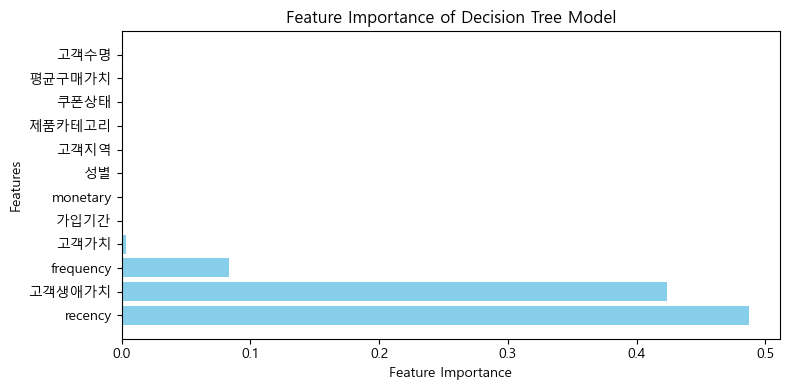

In [65]:
# 최적 모델 얻기
best_model = log_over_grid_dt.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train_over.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=True))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of Decision Tree Model')
plt.tight_layout()
plt.show()

In [74]:
# 각 성능 지표 계산
# train
dt_log_tr_accuracy = accuracy_score(y_train_over, dt_log_y_pred_train)
dt_log_tr_precision = precision_score(y_train_over, dt_log_y_pred_train, average='weighted')
dt_log_tr_recall = recall_score(y_train_over, dt_log_y_pred_train, average='weighted')
dt_log_tr_f1 = f1_score(y_train_over, dt_log_y_pred_train, average='weighted')

# test
dt_log_test_accuracy = accuracy_score(y_test, dt_log_y_pred_test)
dt_log_test_precision = precision_score(y_test, dt_log_y_pred_test, average='weighted')
dt_log_test_recall = recall_score(y_test, dt_log_y_pred_test, average='weighted')
dt_log_test_f1 = f1_score(y_test, dt_log_y_pred_test, average='weighted')

# 성능 지표 출력
print("Train Accuracy:", dt_log_tr_accuracy)
print("Train Precision:", dt_log_tr_precision)
print("Train Recall:", dt_log_tr_recall)
print("Train F1 Score:", dt_log_tr_f1)
print('=' * 50)
print("Test Accuracy:", dt_log_test_accuracy)
print("Test Precision:", dt_log_test_precision)
print("Test Recall:", dt_log_test_recall)
print("Test F1 Score:", dt_log_test_f1)


Train Accuracy: 0.9993120055039559
Train Precision: 0.9993134225883968
Train Recall: 0.9993120055039559
Train F1 Score: 0.9993120047712362
Test Accuracy: 0.9828767123287672
Test Precision: 0.9838709677419355
Test Recall: 0.9828767123287672
Test F1 Score: 0.9831060082748437


In [75]:
# classification report 출력
print("Train Classification Report:")
print(classification_report(y_train_over, dt_log_y_pred_train))

print("Test Classification Report:")
print(classification_report(y_test, dt_log_y_pred_test))

Train Classification Report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.00       969
           2       1.00      1.00      1.00       969
           3       1.00      1.00      1.00       969

    accuracy                           1.00      2907
   macro avg       1.00      1.00      1.00      2907
weighted avg       1.00      1.00      1.00      2907

Test Classification Report:
              precision    recall  f1-score   support

           1       0.90      0.90      0.90        21
           2       0.90      1.00      0.95        28
           3       1.00      0.99      0.99       243

    accuracy                           0.98       292
   macro avg       0.94      0.96      0.95       292
weighted avg       0.98      0.98      0.98       292



In [76]:
# confusion matrix 출력
print("Train Confusion Matrix:")
print(confusion_matrix(y_train_over, dt_log_y_pred_train))

print("Test Confusion Matrix:")
print(confusion_matrix(y_test, dt_log_y_pred_test))

Train Confusion Matrix:
[[969   0   0]
 [  0 969   0]
 [  0   2 967]]
Test Confusion Matrix:
[[ 19   2   0]
 [  0  28   0]
 [  2   1 240]]


### RandomForestClassifier

In [77]:
from sklearn.ensemble import RandomForestClassifier

# StratifiedKFold를 사용한 교차 검증 설정
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=13)

# Random Forest 분류기 생성
random_forest = RandomForestClassifier()

# GridSearchCV를 사용한 모델 검색
param_grid = {
    'n_estimators': [100, 200, 300],  # 트리의 개수
    'max_depth': [3, 6, 9],  # 트리의 최대 깊이
    'min_samples_split': [2, 5, 10],  # 내부 노드를 분할하는 데 필요한 최소 샘플 수
    'min_samples_leaf': [1, 2, 4]  # 리프 노드에 필요한 최소 샘플 수
}

log_over_grid_rf = GridSearchCV(estimator=random_forest, param_grid=param_grid, cv=stratified_kfold, scoring='accuracy')

# 모델 학습
log_over_grid_rf.fit(X_train_over, y_train_over)
rf_log_y_pred_train = log_over_grid_rf.predict(X_train_over)
rf_log_y_pred_test = log_over_grid_rf.predict(X_test)

In [78]:
# 최적의 모델과 파라미터 출력
print("Best parameters found: ", log_over_grid_rf.best_params_)
print("Best accuracy found: ", log_over_grid_rf.best_score_)

score_df = pd.DataFrame(log_over_grid_rf.cv_results_)
score_df[['params', 'rank_test_score', 'mean_test_score', 'std_test_score']].head()

Best parameters found:  {'max_depth': 9, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 200}
Best accuracy found:  0.9951836802290162


,params,rank_test_score,mean_test_score,std_test_score
0,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",72,0.965600,0.007300
1,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",68,0.966287,0.004701
2,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",81,0.964912,0.004694
3,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",78,0.965599,0.006348
4,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",61,0.967320,0.005440


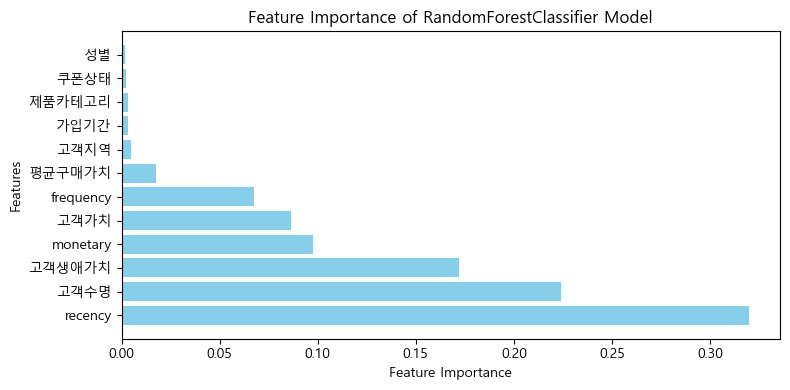

In [79]:
# 최적 모델 얻기
best_model = log_over_grid_rf.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train_over.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=True))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of RandomForestClassifier Model')
plt.tight_layout()
plt.show()

In [80]:
# 각 성능 지표 계산
# train
rf_log_tr_accuracy = accuracy_score(y_train_over, rf_log_y_pred_train)
rf_log_tr_precision = precision_score(y_train_over, rf_log_y_pred_train, average='weighted')
rf_log_tr_recall = recall_score(y_train_over, rf_log_y_pred_train, average='weighted')
rf_log_tr_f1 = f1_score(y_train_over, rf_log_y_pred_train, average='weighted')

# test
rf_log_test_accuracy = accuracy_score(y_test, rf_log_y_pred_test)
rf_log_test_precision = precision_score(y_test, rf_log_y_pred_test, average='weighted')
rf_log_test_recall = recall_score(y_test, rf_log_y_pred_test, average='weighted')
rf_log_test_f1 = f1_score(y_test, rf_log_y_pred_test, average='weighted')

# 성능 지표 출력
print("Train Accuracy:", rf_log_tr_accuracy)
print("Train Precision:", rf_log_tr_precision)
print("Train Recall:", rf_log_tr_recall)
print("Train F1 Score:", rf_log_tr_f1)
print('=' * 50)
print("Test Accuracy:", rf_log_test_accuracy)
print("Test Precision:", rf_log_test_precision)
print("Test Recall:", rf_log_test_recall)
print("Test F1 Score:", rf_log_test_f1)

Train Accuracy: 0.9989680082559339
Train Precision: 0.9989711934156378
Train Recall: 0.9989680082559339
Train F1 Score: 0.9989680057830016
Test Accuracy: 0.9863013698630136
Test Precision: 0.9877037080774681
Test Recall: 0.9863013698630136
Test F1 Score: 0.9866170356830517


In [81]:
# classification report 출력
print("Train Classification Report:")
print(classification_report(y_train_over, rf_log_y_pred_train))

print("Test Classification Report:")
print(classification_report(y_test, rf_log_y_pred_test))

Train Classification Report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.00       969
           2       1.00      1.00      1.00       969
           3       1.00      1.00      1.00       969

    accuracy                           1.00      2907
   macro avg       1.00      1.00      1.00      2907
weighted avg       1.00      1.00      1.00      2907

Test Classification Report:
              precision    recall  f1-score   support

           1       0.88      1.00      0.93        21
           2       0.97      1.00      0.98        28
           3       1.00      0.98      0.99       243

    accuracy                           0.99       292
   macro avg       0.95      0.99      0.97       292
weighted avg       0.99      0.99      0.99       292



In [82]:
# confusion matrix 출력
print("Train Confusion Matrix:")
print(confusion_matrix(y_train_over, rf_log_y_pred_train))

print("Test Confusion Matrix:")
print(confusion_matrix(y_test, rf_log_y_pred_test))

Train Confusion Matrix:
[[969   0   0]
 [  0 969   0]
 [  0   3 966]]
Test Confusion Matrix:
[[ 21   0   0]
 [  0  28   0]
 [  3   1 239]]


### LGBMClassifier

In [83]:
from lightgbm import LGBMClassifier

# StratifiedKFold를 사용한 교차 검증 설정
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# LightGBM 분류기 생성
lgbm_classifier = LGBMClassifier()

# GridSearchCV를 사용한 모델 검색
param_grid = {
    'learning_rate': [0.01, 0.05, 0.1], # 각 트리의 가중치 업데이트에 사용되는 학습률
    'n_estimators': [100, 200, 300], # 생성할 트리의 수
    'max_depth': [3, 6, 9], 
    'min_child_weight': [1, 2, 4], # 각 트리에서 샘플의 최소 가중치 총합, 값이 높을수록 모델은 보수적으로 편향
}

log_over_grid_lgbm = GridSearchCV(estimator=lgbm_classifier, param_grid=param_grid, cv=stratified_kfold, scoring='accuracy')

# 모델 학습
log_over_grid_lgbm.fit(X_train_over, y_train_over)
lgbm_log_y_pred_train = log_over_grid_lgbm.predict(X_train_over)
lgbm_log_y_pred_test = log_over_grid_lgbm.predict(X_test)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000506 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2609
[LightGBM] [Info] Number of data points in the train set: 2325, number of used features: 12
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Info] Start training from score -1.098612
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

In [84]:
# 최적의 모델과 파라미터 출력
print("Best parameters found: ", log_over_grid_lgbm.best_params_)
print("Best accuracy found: ", log_over_grid_lgbm.best_score_)

score_df = pd.DataFrame(log_over_grid_lgbm.cv_results_)
score_df[['params', 'rank_test_score', 'mean_test_score', 'std_test_score']].head()

Best parameters found:  {'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 2, 'n_estimators': 200}
Best accuracy found:  0.9948388546823524


,params,rank_test_score,mean_test_score,std_test_score
0,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",79,0.983485,0.005404
1,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",76,0.988299,0.007174
2,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",68,0.992429,0.003710
3,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",79,0.983485,0.005404
4,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",76,0.988299,0.007174


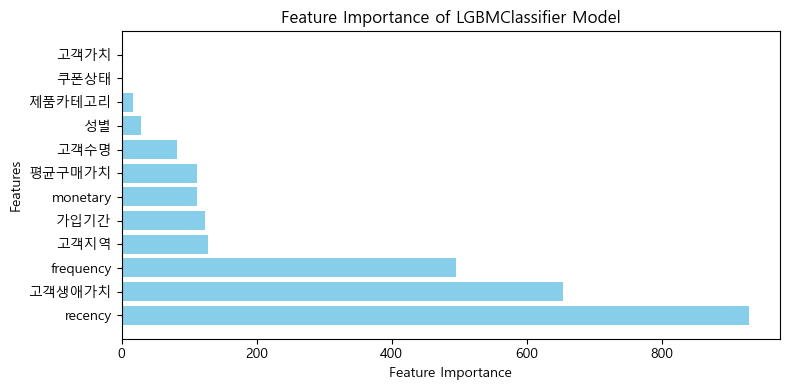

In [85]:
# 최적 모델 얻기
best_model = log_over_grid_lgbm.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train_over.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=True))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of LGBMClassifier Model')
plt.tight_layout()
plt.show()

In [86]:
# 각 성능 지표 계산
# train
lgbm_log_tr_accuracy = accuracy_score(y_train_over, lgbm_log_y_pred_train)
lgbm_log_tr_precision = precision_score(y_train_over, lgbm_log_y_pred_train, average='weighted')
lgbm_log_tr_recall = recall_score(y_train_over, lgbm_log_y_pred_train, average='weighted')
lgbm_log_tr_f1 = f1_score(y_train_over, lgbm_log_y_pred_train, average='weighted')

# test
lgbm_log_test_accuracy = accuracy_score(y_test, lgbm_log_y_pred_test)
lgbm_log_test_precision = precision_score(y_test, lgbm_log_y_pred_test, average='weighted')
lgbm_log_test_recall = recall_score(y_test, lgbm_log_y_pred_test, average='weighted')
lgbm_log_test_f1 = f1_score(y_test, lgbm_log_y_pred_test, average='weighted')

# 성능 지표 출력
print("Train Accuracy:", lgbm_log_tr_accuracy)
print("Train Precision:", lgbm_log_tr_precision)
print("Train Recall:", lgbm_log_tr_recall)
print("Train F1 Score:", lgbm_log_tr_f1)
print('=' * 50)
print("Test Accuracy:", lgbm_log_test_accuracy)
print("Test Precision:", lgbm_log_test_precision)
print("Test Recall:", lgbm_log_test_recall)
print("Test F1 Score:", lgbm_log_test_f1)

Train Accuracy: 1.0
Train Precision: 1.0
Train Recall: 1.0
Train F1 Score: 1.0
Test Accuracy: 0.9863013698630136
Test Precision: 0.9871243923994698
Test Recall: 0.9863013698630136
Test F1 Score: 0.9864231287300756


In [87]:
# classification report 출력
print("Train Classification Report:")
print(classification_report(y_train_over, lgbm_log_y_pred_train))

print("Test Classification Report:")
print(classification_report(y_test, lgbm_log_y_pred_test))

Train Classification Report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.00       969
           2       1.00      1.00      1.00       969
           3       1.00      1.00      1.00       969

    accuracy                           1.00      2907
   macro avg       1.00      1.00      1.00      2907
weighted avg       1.00      1.00      1.00      2907

Test Classification Report:
              precision    recall  f1-score   support

           1       0.95      0.90      0.93        21
           2       0.90      1.00      0.95        28
           3       1.00      0.99      1.00       243

    accuracy                           0.99       292
   macro avg       0.95      0.97      0.96       292
weighted avg       0.99      0.99      0.99       292



In [88]:
# confusion matrix 출력
print("Train Confusion Matrix:")
print(confusion_matrix(y_train_over, lgbm_log_y_pred_train))

print("Test Confusion Matrix:")
print(confusion_matrix(y_test, lgbm_log_y_pred_test))

Train Confusion Matrix:
[[969   0   0]
 [  0 969   0]
 [  0   0 969]]
Test Confusion Matrix:
[[ 19   2   0]
 [  0  28   0]
 [  1   1 241]]


### 모델 점수화_log

In [89]:
# 각 모델의 성능 지표를 데이터프레임으로 저장
dt_scores = pd.DataFrame({
    'Model': ['Decision Tree_log'],
    'Dataset': ['Test'],
    'Best estimator' : [log_over_grid_dt.best_estimator_],
    'Accuracy': [dt_log_test_accuracy],
    'Precision': [dt_log_test_precision],
    'Recall': [dt_log_test_recall],
    'F1 Score': [dt_log_test_f1]
})

rf_scores = pd.DataFrame({
    'Model': ['Random Forest_log'],
    'Dataset': ['Test'],
    'Best estimator' : [log_over_grid_rf.best_estimator_],
    'Accuracy': [rf_log_test_accuracy],
    'Precision': [rf_log_test_precision],
    'Recall': [rf_log_test_recall],
    'F1 Score': [rf_log_test_f1]
})

lgbm_scores = pd.DataFrame({
    'Model': ['LGBMClassifier_log'],
    'Dataset': ['Test'],
    'Best estimator' : [log_over_grid_lgbm.best_estimator_],
    'Accuracy': [lgbm_log_test_accuracy],
    'Precision': [lgbm_log_test_precision],
    'Recall': [lgbm_log_test_recall],
    'F1 Score': [lgbm_log_test_f1]
})

# 세 데이터프레임을 합치기
all_scores_log = pd.concat([dt_scores, rf_scores, lgbm_scores], ignore_index=True)

In [90]:
over_model_score = pd.concat([all_scores, all_scores_log], ignore_index=True)
over_model_score

,Model,Dataset,Best estimator,Accuracy,Precision,Recall,F1 Score
0,Decision Tree,Test,"DecisionTreeClassifier(max_depth=9, min_sample...",0.986301,0.987124,0.986301,0.986423
1,Random Forest,Test,"(DecisionTreeClassifier(max_depth=9, max_featu...",0.989726,0.990307,0.989726,0.989840
2,LGBMClassifier,Test,"LGBMClassifier(learning_rate=0.05, max_depth=3...",0.989726,0.990011,0.989726,0.989715
3,Decision Tree_log,Test,DecisionTreeClassifier(max_depth=9),0.982877,0.983871,0.982877,0.983106
4,Random Forest_log,Test,"(DecisionTreeClassifier(max_depth=9, max_featu...",0.986301,0.987704,0.986301,0.986617
5,LGBMClassifier_log,Test,"LGBMClassifier(learning_rate=0.05, max_depth=3...",0.986301,0.987124,0.986301,0.986423


In [91]:
over_model_score.to_csv("../data/over_model_score.csv", encoding="utf-8")

In [92]:
over_model_score.sort_values(by=['Accuracy', 'F1 Score'], ascending=False)

,Model,Dataset,Best estimator,Accuracy,Precision,Recall,F1 Score
1,Random Forest,Test,"(DecisionTreeClassifier(max_depth=9, max_featu...",0.989726,0.990307,0.989726,0.989840
2,LGBMClassifier,Test,"LGBMClassifier(learning_rate=0.05, max_depth=3...",0.989726,0.990011,0.989726,0.989715
4,Random Forest_log,Test,"(DecisionTreeClassifier(max_depth=9, max_featu...",0.986301,0.987704,0.986301,0.986617
0,Decision Tree,Test,"DecisionTreeClassifier(max_depth=9, min_sample...",0.986301,0.987124,0.986301,0.986423
5,LGBMClassifier_log,Test,"LGBMClassifier(learning_rate=0.05, max_depth=3...",0.986301,0.987124,0.986301,0.986423
3,Decision Tree_log,Test,DecisionTreeClassifier(max_depth=9),0.982877,0.983871,0.982877,0.983106


### 마지막 테스트
- Random Forest, oversampling, logscale X

In [93]:
df_final_test = df_final.copy()
df_final_test

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1049,0,3,31,181,87,8382.63,8,0,96.352069,8382.63,6,50295.78,non-vip
1,USER_0040,1,3,39,167,14,1057.78,1,0,75.555714,1057.78,6,6346.68,non-vip
2,USER_0026,0,0,32,266,147,17418.69,1,0,118.494490,17418.69,3,52256.07,non-vip
3,USER_1077,0,1,39,19,105,10925.66,1,0,104.053905,10925.66,10,109256.60,vip
4,USER_1355,0,0,21,18,572,50786.24,1,0,88.787133,50786.24,10,507862.40,vip
5,USER_1267,1,1,25,22,213,18226.01,1,0,85.568122,18226.01,10,182260.10,vip
6,USER_0414,0,1,45,64,115,11704.94,1,0,101.782087,11704.94,9,105344.46,잠재적vip
7,USER_1000,1,4,50,82,59,4776.45,1,0,80.956780,4776.45,8,38211.60,잠재적vip
8,USER_0608,1,1,26,103,59,4834.26,8,0,81.936610,4834.26,8,38674.08,잠재적vip


In [94]:
# vip 컬럼의 값을 숫자로 변환
df_final_test['vip'] = df_final_test['vip'].map({'non-vip': 3, 'vip': 1, '잠재적vip': 2})
df_final_test


,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1049,0,3,31,181,87,8382.63,8,0,96.352069,8382.63,6,50295.78,3
1,USER_0040,1,3,39,167,14,1057.78,1,0,75.555714,1057.78,6,6346.68,3
2,USER_0026,0,0,32,266,147,17418.69,1,0,118.494490,17418.69,3,52256.07,3
3,USER_1077,0,1,39,19,105,10925.66,1,0,104.053905,10925.66,10,109256.60,1
4,USER_1355,0,0,21,18,572,50786.24,1,0,88.787133,50786.24,10,507862.40,1
5,USER_1267,1,1,25,22,213,18226.01,1,0,85.568122,18226.01,10,182260.10,1
6,USER_0414,0,1,45,64,115,11704.94,1,0,101.782087,11704.94,9,105344.46,2
7,USER_1000,1,4,50,82,59,4776.45,1,0,80.956780,4776.45,8,38211.60,2
8,USER_0608,1,1,26,103,59,4834.26,8,0,81.936610,4834.26,8,38674.08,2


In [95]:
X_final_test = df_final_test.drop(columns=['고객ID', 'vip'], axis=1)
y_final_test = df_final_test['vip']
X_final_test

,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치
0,0,3,31,181,87,8382.63,8,0,96.352069,8382.63,6,50295.78
1,1,3,39,167,14,1057.78,1,0,75.555714,1057.78,6,6346.68
2,0,0,32,266,147,17418.69,1,0,118.494490,17418.69,3,52256.07
3,0,1,39,19,105,10925.66,1,0,104.053905,10925.66,10,109256.60
4,0,0,21,18,572,50786.24,1,0,88.787133,50786.24,10,507862.40
5,1,1,25,22,213,18226.01,1,0,85.568122,18226.01,10,182260.10
6,0,1,45,64,115,11704.94,1,0,101.782087,11704.94,9,105344.46
7,1,4,50,82,59,4776.45,1,0,80.956780,4776.45,8,38211.60
8,1,1,26,103,59,4834.26,8,0,81.936610,4834.26,8,38674.08


In [96]:
# Random Forest, oversampling, logscale X
best_model = over_grid_rf.best_estimator_

X_final_pred = best_model.predict(X_final_test)

df_final_test['vip_pred'] = X_final_pred


In [97]:
df_final_test

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip,vip_pred
0,USER_1049,0,3,31,181,87,8382.63,8,0,96.352069,8382.63,6,50295.78,3,3
1,USER_0040,1,3,39,167,14,1057.78,1,0,75.555714,1057.78,6,6346.68,3,3
2,USER_0026,0,0,32,266,147,17418.69,1,0,118.494490,17418.69,3,52256.07,3,3
3,USER_1077,0,1,39,19,105,10925.66,1,0,104.053905,10925.66,10,109256.60,1,1
4,USER_1355,0,0,21,18,572,50786.24,1,0,88.787133,50786.24,10,507862.40,1,1
5,USER_1267,1,1,25,22,213,18226.01,1,0,85.568122,18226.01,10,182260.10,1,1
6,USER_0414,0,1,45,64,115,11704.94,1,0,101.782087,11704.94,9,105344.46,2,2
7,USER_1000,1,4,50,82,59,4776.45,1,0,80.956780,4776.45,8,38211.60,2,2
8,USER_0608,1,1,26,103,59,4834.26,8,0,81.936610,4834.26,8,38674.08,2,2


### OverSampling RandomForestClassifier_shap value 확인

### SHAP(SHapley Additive exPlanations)
- 머신러닝 모델의 예측을 설명하는 데 사용되는 도구
- SHAP은 각 특성이 모델의 예측에 어떻게 기여하는지를 설명하는 데 중점을 두며, 개별 예측에 대한 이해를 제공

In [98]:
import shap

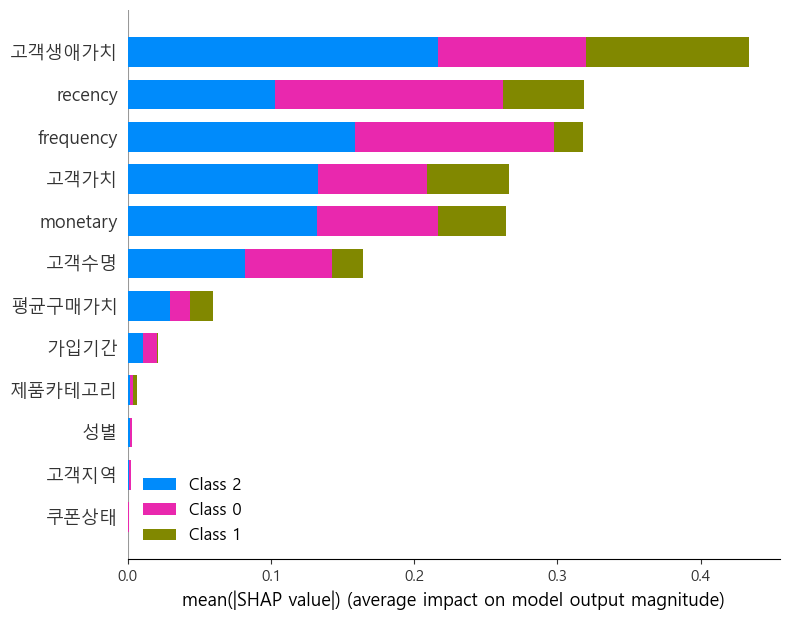

In [99]:
# SHAP을 이용한 모델 예측 설명
best_model = over_grid_rf.best_estimator_
explainer = shap.Explainer(best_model)
shap_values = explainer.shap_values(X_test)

# 특성의 이름을 리스트로 생성
feature_names = X_test.columns.tolist()

# SHAP 값을 정렬하여 중요도가 높은 순서대로 시각화
shap.summary_plot(shap_values, X_test, feature_names=feature_names, plot_type="bar", sort=True)
plt.show()

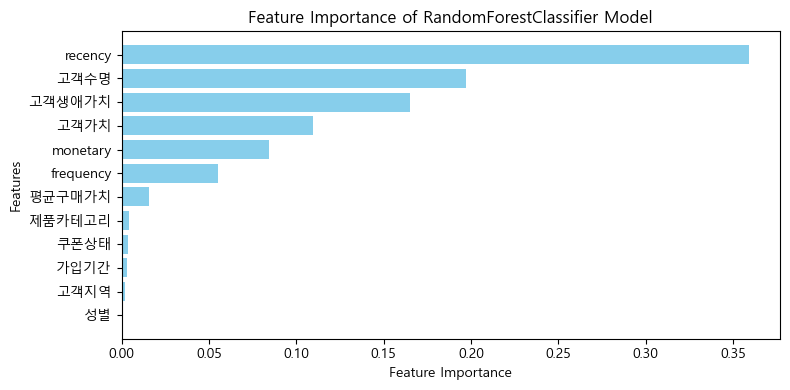

In [100]:
# 최적 모델 얻기
best_model = over_grid_rf.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train_over.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=False))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of RandomForestClassifier Model')
plt.tight_layout()
plt.show()